# Set Up

In [1]:
import numpy as np
import numpy.random as random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
# import scarches as sca

In [2]:
import session_info
session_info.show()

In [7]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=200, facecolor='white', color_map = 'RdPu',dpi_save=300)

# Paths & variables

In [5]:
#set relevant label key
compartment='AllCompartments'
cell_type_key = 'MidGrainModified'
batch_key='batch_key'
job_name=f'AtlasT21_WithContCovariates_{cell_type_key}_{compartment}'
job_name

'AtlasT21_WithContCovariates_MidGrainModified_AllCompartments'

In [5]:
#paths
base_path='/lustre/scratch126/cellgen/team205/jc48/jupyter/scArches'
data_dir=os.path.join(base_path,'data')
results_dir=os.path.join(base_path,f'results/{job_name}')
adata_path=os.path.join(results_dir,'anndata/')
models_path=os.path.join(results_dir,'models/')

# Read in data

## Atlas

In [6]:
# reference data
adata_ref = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Feb28ObjectRaw.h5ad')

# subset as appropriate
print(adata_ref.shape)
if compartment != "AllCompartments":
    adata_ref = adata_ref[adata_ref.obs.coarse_grain==compartment]
print(adata_ref.shape)

# Modify the mid_grain label since the CCS cells bridge two major clusters
rename_dict = {
    "SinoatrialNodeCardiomyocytes": "AtrialCardiomyocytes",
    "AtrioventricularNodeCardiomyocytes": "AtrialCardiomyocytes",
    "VentricularConductionSystemDistal": "VentricularCardiomyocytes",
    "VentricularConductionSystemProximal": "VentricularCardiomyocytes"
}

# Create the "MidGrainModified" column using the mapping logic
adata_ref.obs["MidGrainModified"] = adata_ref.obs["fine_grain"].map(rename_dict).fillna(adata_ref.obs["mid_grain"])

print(adata_ref.shape)

(297473, 36601)
(297473, 36601)
(297473, 36601)


## T21

In [7]:
file_path=os.path.join(data_dir,'T21HeartsExtracardiacRemovedRaw.h5ad')
adata_que=sc.read(file_path)

# subset as appropriate
print(adata_que.shape)
if compartment != "AllCompartments":
    adata_que = adata_que[adata_que.obs.coarse_grain==compartment]
print(adata_que.shape)

(76358, 36601)
(76358, 36601)


# Concatenate to make full object

In [8]:
# concatenate
adata = adata_ref.concatenate(adata_que, 
                              index_unique = None, 
                              batch_key= 'original_or_new',
                                  batch_categories=['original','new'])
del adata.obsm['X_scVI']
del adata.obsm['X_umap']
del adata.obsm['_scvi_extra_continuous_covs']
del adata.obsm['_scvi_extra_categorical_covs']
del adata.obsm['latent_gene_encoding']

adata

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


AnnData object with n_obs × n_vars = 373831 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'region', 'age', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', 'FACSgate', 'fine_grain', 'mid_grain', 'coarse_grain', 'sex', 'week', 'trimester', 'heart_or_greatvessels', 'cycling', 'S_score', 'G2M_score', 'phase', '_scvi_labels', 'stress_score', 'hb1_score', 'MidGrainModified', 'leiden', 'original_or_new'
    var: 'gene_id', 'feature_type-new', 'ambient_expression-0-new', 'ambient_expre

In [9]:
adata.obs.head(3)

,latent_RT_efficiency,latent_cell_probability,latent_scale,sangerID,combinedID,donor,region,age,facility,cell_or_nuclei,...,cycling,S_score,G2M_score,phase,_scvi_labels,stress_score,hb1_score,MidGrainModified,leiden,original_or_new
barcode,,,,,,,,,,,,,,,,,,,,,
BHF_F_Hea10402917_TGGCTGGGTTGTGGAG-1,5.218614,0.999939,123665.210938,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,yes,0.002509,-0.056211,S,0.0,0.611262,-0.238230,BloodVesselEndothelialCells,NaN,original
BHF_F_Hea10402917_ATGTGTGTCGAACGGA-1,3.109560,0.999991,10201.502930,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,yes,0.726850,0.094688,S,0.0,1.123909,-0.121226,LymphoidCells,NaN,original
BHF_F_Hea10402917_CAGGTGCAGGCTATCT-1,3.181446,0.999989,10217.305664,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,yes,0.413170,1.200272,G2M,0.0,0.502809,-0.134926,LymphoidCells,NaN,original


In [10]:
adata.var.head(3)

,gene_id,feature_type-new,ambient_expression-0-new,ambient_expression-1-new,ambient_expression-2-new,ambient_expression-3-new,ambient_expression-4-new,ambient_expression-5-new,ambient_expression-6-new,ambient_expression-7-new,mt-new,ribo-new,n_cells_by_counts-new,mean_counts-new,log1p_mean_counts-new,pct_dropout_by_counts-new,total_counts-new,log1p_total_counts-new,gene_name_scRNA-0-original
MIR1302-2HG,ENSG00000243485,Gene Expression,4.573488e-07,0.0,3.450878e-15,0.0,0.0,0.0,0.0,0.0,False,False,3,0.000027,0.000027,99.997298,3.0,1.386294,MIR1302-2HG
FAM138A,ENSG00000237613,Gene Expression,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,False,False,0,0.000000,0.000000,100.000000,0.0,0.000000,FAM138A
OR4F5,ENSG00000186092,Gene Expression,4.572271e-07,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,False,False,0,0.000000,0.000000,100.000000,0.0,0.000000,OR4F5


In [11]:
adata.X.data[:10]

array([ 1.,  1.,  5.,  5.,  8.,  4., 13.,  4.,  3.,  1.], dtype=float32)

# Add metadata

In [12]:
# add age as a continous variable
import re

def age_to_days(age_str):
    match = re.match(r'(\d+)W(\d+)D', age_str)
    if match:
        weeks, days = map(int, match.groups())
        return float(weeks * 7 + days)
    else:
        return None

# Assuming 'adata' is an AnnData object
adata.obs['age_days'] = adata.obs['age'].apply(age_to_days)
adata.obs['age_days']=adata.obs['age_days'].astype(float)

In [13]:
adata.obs['diagnosis'] = adata.obs['original_or_new'].map({'original': 'Atlas', 'new': 'T21'})
adata.obs.diagnosis.value_counts()

diagnosis
Atlas    297473
T21       76358
Name: count, dtype: int64

In [14]:
import genomic_features as gf
ensdb = gf.ensembl.annotation(species="Hsapiens", version="109")
genes = ensdb.genes()
genes.head(3)

,gene_id,gene_name,gene_biotype,gene_seq_start,gene_seq_end,seq_name,seq_strand,seq_coord_system,description,gene_id_version,canonical_transcript
0,ENSG00000000003,TSPAN6,protein_coding,100627108,100639991,X,-1,chromosome,tetraspanin 6 [Source:HGNC Symbol;Acc:HGNC:11858],ENSG00000000003.15,ENST00000373020
1,ENSG00000000005,TNMD,protein_coding,100584936,100599885,X,1,chromosome,tenomodulin [Source:HGNC Symbol;Acc:HGNC:17757],ENSG00000000005.6,ENST00000373031
2,ENSG00000000419,DPM1,protein_coding,50934867,50959140,20,-1,chromosome,dolichyl-phosphate mannosyltransferase subunit...,ENSG00000000419.14,ENST00000371588


In [15]:
adata.var = (
    adata.var.reset_index(names='GENE_NAME')
    .merge(genes, on="gene_id", how='left')
    .set_index("GENE_NAME")
)

adata.var['sex_chromosome']=adata.var.seq_name.isin(['X','Y'])

adata.var.head(3)

,gene_id,feature_type-new,ambient_expression-0-new,ambient_expression-1-new,ambient_expression-2-new,ambient_expression-3-new,ambient_expression-4-new,ambient_expression-5-new,ambient_expression-6-new,ambient_expression-7-new,...,gene_biotype,gene_seq_start,gene_seq_end,seq_name,seq_strand,seq_coord_system,description,gene_id_version,canonical_transcript,sex_chromosome
GENE_NAME,,,,,,,,,,,,,,,,,,,,,
MIR1302-2HG,ENSG00000243485,Gene Expression,4.573488e-07,0.0,3.450878e-15,0.0,0.0,0.0,0.0,0.0,...,lncRNA,29554.0,31109.0,1,1.0,chromosome,MIR1302-2 host gene [Source:HGNC Symbol;Acc:HG...,ENSG00000243485.5,ENST00000473358,False
FAM138A,ENSG00000237613,Gene Expression,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,...,lncRNA,34554.0,36081.0,1,-1.0,chromosome,family with sequence similarity 138 member A [...,ENSG00000237613.2,ENST00000417324,False
OR4F5,ENSG00000186092,Gene Expression,4.572271e-07,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,...,protein_coding,65419.0,71585.0,1,1.0,chromosome,olfactory receptor family 4 subfamily F member...,ENSG00000186092.7,ENST00000641515,False


# Add in scArches data

## Latent space

In [16]:
file_path=os.path.join(adata_path,f'{job_name}_full_latent.h5ad')
full_latent=sc.read(file_path)
full_latent

AnnData object with n_obs × n_vars = 373831 × 50
    obs: 'cell_type', 'batch', 'predictions', 'original_or_new'
    uns: 'batch_colors', 'cell_type_colors', 'neighbors', 'original_or_new_colors', 'predictions_colors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

In [17]:
latent_X=pd.DataFrame(full_latent.X)
latent_X.index=full_latent.obs_names
latent_X.head(3)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
barcode,,,,,,,,,,,,,,,,,,,,,
BHF_F_Hea10402917_TGGCTGGGTTGTGGAG-1,-1.377381,9.909132,-3.151613,7.963450,-1.902352,-0.491161,3.091085,-1.848081,-0.031881,12.387289,...,0.641399,-1.457763,-3.956940,-0.090518,-3.895600,10.122224,3.230771,-9.743806,1.354254,11.379145
BHF_F_Hea10402917_ATGTGTGTCGAACGGA-1,4.022424,-1.272919,-0.830113,-6.646864,6.092866,8.133634,-2.867570,7.911288,4.644070,-3.789826,...,0.373095,6.868208,-4.580621,-1.429293,-0.808689,1.150168,-2.887591,5.247543,1.429992,-8.583064
BHF_F_Hea10402917_CAGGTGCAGGCTATCT-1,2.713453,4.244389,-6.252040,-6.105433,7.694505,10.663616,1.142860,7.075295,-5.333079,1.201808,...,-0.290489,6.808071,-9.392072,6.407761,-5.603294,8.790939,0.647720,4.323895,1.393415,-6.895191


In [18]:
adata.obsm['X_scArches']=latent_X

## scANVI predictions

In [19]:
# Get a list of columns that are only present in the second DataFrame
cols_to_add = full_latent.obs.columns.difference(adata.obs.columns)

# Merge only those columns from second DataFrame which are not present in the first DataFrame
adata.obs = adata.obs.merge(full_latent.obs[cols_to_add], left_index=True, right_index=True, how='inner')
adata.obs.rename(columns={'predictions':'scANVI_predictions'},inplace=True)
adata.obs.head(3)

,latent_RT_efficiency,latent_cell_probability,latent_scale,sangerID,combinedID,donor,region,age,facility,cell_or_nuclei,...,stress_score,hb1_score,MidGrainModified,leiden,original_or_new,age_days,diagnosis,batch,cell_type,scANVI_predictions
barcode,,,,,,,,,,,,,,,,,,,,,
BHF_F_Hea10402917_TGGCTGGGTTGTGGAG-1,5.218614,0.999939,123665.210938,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,0.611262,-0.238230,BloodVesselEndothelialCells,NaN,original,75.0,Atlas,C86_Cell_5prime-v2,BloodVesselEndothelialCells,BloodVesselEndothelialCells
BHF_F_Hea10402917_ATGTGTGTCGAACGGA-1,3.109560,0.999991,10201.502930,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,1.123909,-0.121226,LymphoidCells,NaN,original,75.0,Atlas,C86_Cell_5prime-v2,LymphoidCells,LymphoidCells
BHF_F_Hea10402917_CAGGTGCAGGCTATCT-1,3.181446,0.999989,10217.305664,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,0.502809,-0.134926,LymphoidCells,NaN,original,75.0,Atlas,C86_Cell_5prime-v2,LymphoidCells,LymphoidCells


In [20]:
set(adata.obs[cell_type_key])

{'AtrialCardiomyocytes',
 'BloodVesselEndothelialCells',
 'EndocardialCells',
 'EpicardialCells',
 'Fibroblasts',
 'Glia',
 'LymphaticEndothelialCells',
 'LymphoidCells',
 'MuralCells',
 'MyeloidCells',
 'Neurons',
 'PericardialCells',
 'VentricularCardiomyocytes',
 nan}

In [21]:
adata.obs[cell_type_key] = adata.obs[cell_type_key].astype('str')
adata.obs.loc[adata_que.obs_names,cell_type_key] = adata.obs.loc[adata_que.obs_names,'scANVI_predictions'].astype('str')
set(adata.obs[cell_type_key])

{'AtrialCardiomyocytes',
 'BloodVesselEndothelialCells',
 'EndocardialCells',
 'EpicardialCells',
 'Fibroblasts',
 'Glia',
 'LymphaticEndothelialCells',
 'LymphoidCells',
 'MuralCells',
 'MyeloidCells',
 'Neurons',
 'PericardialCells',
 'VentricularCardiomyocytes'}

In [22]:
adata

AnnData object with n_obs × n_vars = 373831 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'region', 'age', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', 'FACSgate', 'fine_grain', 'mid_grain', 'coarse_grain', 'sex', 'week', 'trimester', 'heart_or_greatvessels', 'cycling', 'S_score', 'G2M_score', 'phase', '_scvi_labels', 'stress_score', 'hb1_score', 'MidGrainModified', 'leiden', 'original_or_new', 'age_days', 'diagnosis', 'batch', 'cell_type', 'scANVI_predictions'
    var: 'gen

# Add in CellTypist labels

In [23]:
label_types=["coarse","mid","fine"]

list_of_label_dfs=[]


for label_type in label_types:
    # read in labels
    labels=pd.read_csv(f'/nfs/team205/heart/anndata_objects/Foetal/trisomy21/CellTypist_labelling/T21_predictions_{label_type}_df.csv', index_col=0)
    labels=labels.add_prefix(label_type+'_')
    list_of_label_dfs.append(labels)

all_labels=pd.concat(list_of_label_dfs, axis=1)
print(all_labels.shape)
all_labels.head(3)

(76358, 9)


,coarse_predicted_labels,coarse_prob,coarse_prob_minus_background,mid_predicted_labels,mid_prob,mid_prob_minus_background,fine_predicted_labels,fine_prob,fine_prob_minus_background
X,,,,,,,,,
BHF_F_Hea13188319_BHF_F_Hea13187621_TAAGGACCATGTCAAT-1,Mesenchymal,0.929917,0.929635,MuralCells,0.402490,0.402208,CoronarySmoothMuscleCells,0.255889,0.255607
BHF_F_Hea13188319_BHF_F_Hea13187621_CGTTTCTCATGAATCT-1,Endothelium,0.970691,0.970534,BloodVesselEndothelialCells,0.993314,0.993157,CoronarySmoothMuscleCells,0.023086,0.022930
BHF_F_Hea13188319_BHF_F_Hea13187621_GATCACTAGCACGTTG-1,Mesenchymal,0.999997,0.999879,PericardialCells,0.817508,0.817390,GreatVesselAdventitialFibroblasts,0.007167,0.007049


In [24]:
# Save the categorical columns names
categorical_cols = adata.obs.select_dtypes(['category']).columns

# Convert all categorical columns to object type
for col in categorical_cols:
    adata.obs[col] = adata.obs[col].astype('object')

# Save original columns
original_cols = adata.obs.columns

# Join operation
adata.obs = adata.obs.join(all_labels, how='left')

# Identify newly added columns
new_cols = [col for col in adata.obs.columns if col not in original_cols]

# Fill NA only in new columns
#for col in new_cols:
#    adata.obs[col].fillna('atlas', inplace=True)

# Convert to columns to categorical
predicted_label_cols = ['fine_predicted_labels','mid_predicted_labels','coarse_predicted_labels']
all_categorical_cols = categorical_cols.tolist() + predicted_label_cols

for col in all_categorical_cols:
    adata.obs[col] = adata.obs[col].astype('category')

adata.obs.iloc[:,-14:].dtypes

age_days                         float64
diagnosis                       category
batch                           category
cell_type                       category
scANVI_predictions              category
coarse_predicted_labels         category
coarse_prob                      float64
coarse_prob_minus_background     float64
mid_predicted_labels            category
mid_prob                         float64
mid_prob_minus_background        float64
fine_predicted_labels           category
fine_prob                        float64
fine_prob_minus_background       float64
dtype: object

# Plotting

## Compute UMAP

In [25]:
%%time
sc.pp.neighbors(adata, use_rep="X_scArches")

computing neighbors


/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/lustre/

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:06)
CPU times: user 1min 37s, sys: 3.85 s, total: 1min 41s
Wall time: 1min 6s


In [26]:
%time
sc.tl.umap(adata, min_dist=0.01)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 6.2 µs
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:54)


## UMAP Plots

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


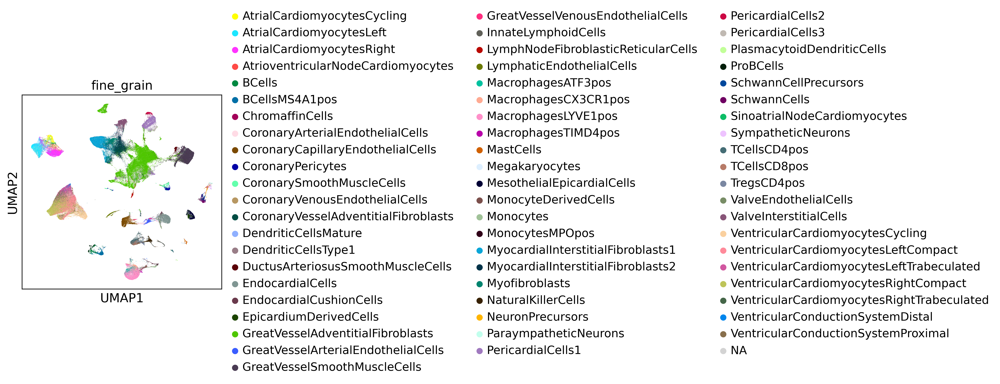

In [27]:
sc.pl.umap(adata, color=["fine_grain"],ncols=1)

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


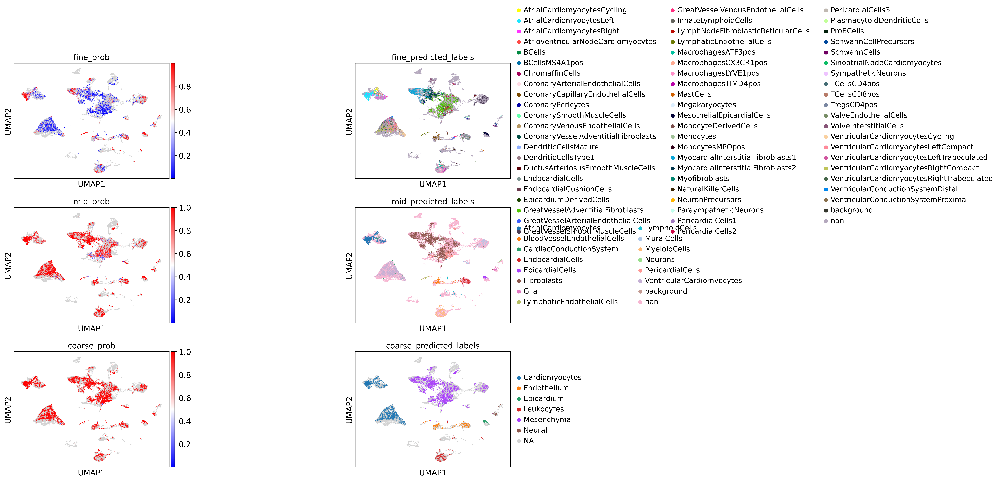

In [17]:
cols = ['fine_prob','fine_predicted_labels',
       'mid_prob','mid_predicted_labels',
       'coarse_prob','coarse_predicted_labels']
sc.pl.umap(adata, color=cols, ncols=2, wspace=1,cmap='bwr')

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch1

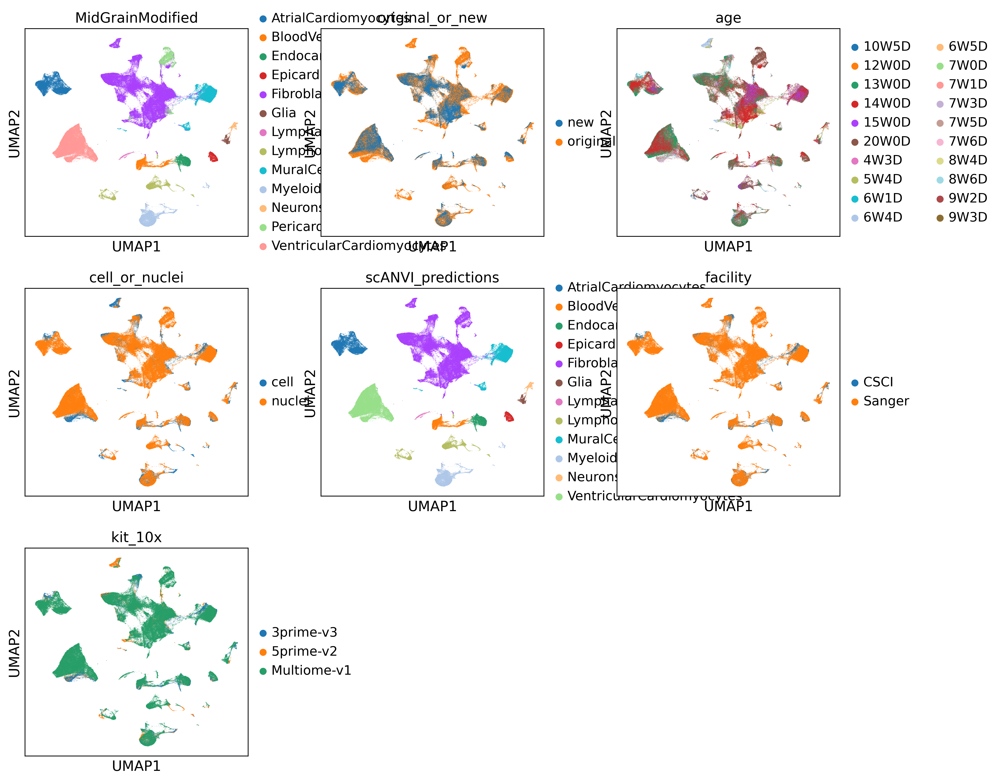

In [29]:
sc.pl.umap(adata, color=[cell_type_key,"original_or_new","age","cell_or_nuclei","scANVI_predictions","facility","kit_10x"],ncols=3)

In [30]:
adata.obs['fine_grain'] = adata.obs['fine_grain'].astype('str')
adata.obs['fine_predicted_labels'] = adata.obs['fine_predicted_labels'].astype('str')
adata.obs['fine_grain_integrated'] = adata.obs['fine_grain'].replace('nan', np.nan).fillna(adata.obs['fine_predicted_labels'].replace('nan', np.nan))
adata.obs['fine_grain_integrated'] = adata.obs['fine_grain_integrated'].astype('category')

In [31]:
adata.obs['mid_grain'] = adata.obs['mid_grain'].astype('str')
adata.obs['mid_predicted_labels'] = adata.obs['mid_predicted_labels'].astype('str')
adata.obs['mid_grain_integrated'] = adata.obs['mid_grain'].replace('nan', np.nan).fillna(adata.obs['mid_predicted_labels'].replace('nan', np.nan))
adata.obs['mid_grain_integrated'] = adata.obs['mid_grain_integrated'].astype('category')

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


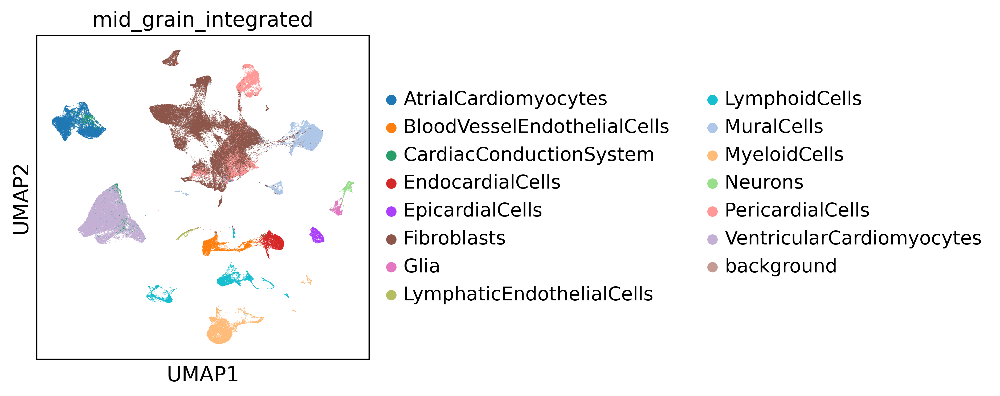

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


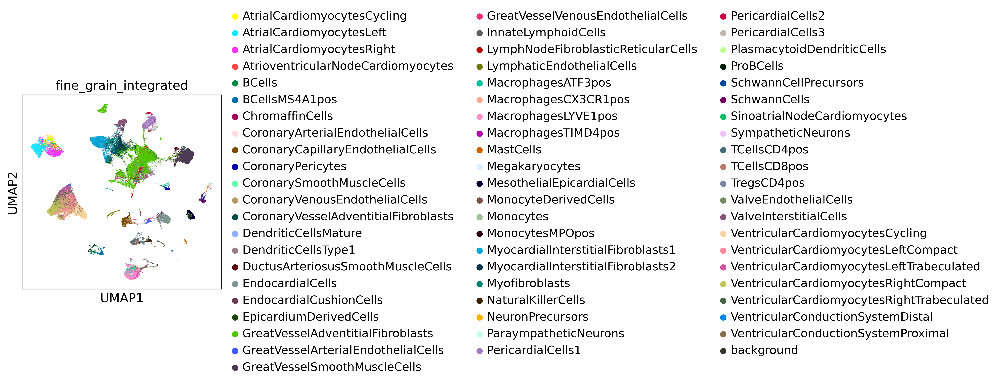

In [32]:
sc.pl.umap(adata, color=["mid_grain_integrated"],ncols=1)
sc.pl.umap(adata, color=["fine_grain_integrated"],ncols=1)

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


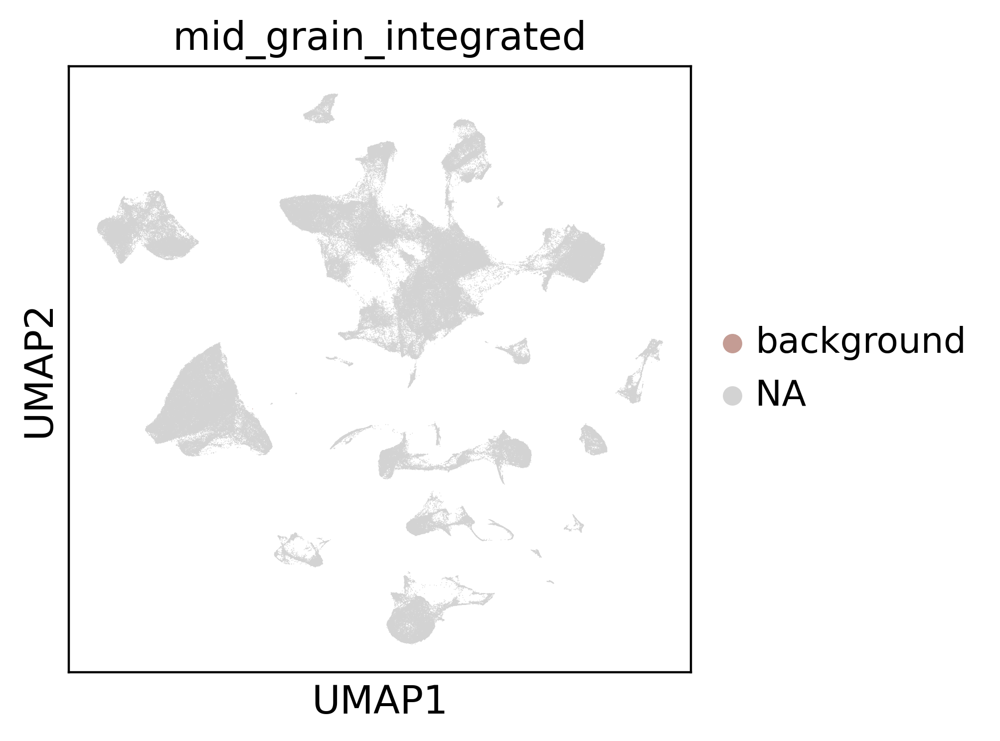

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


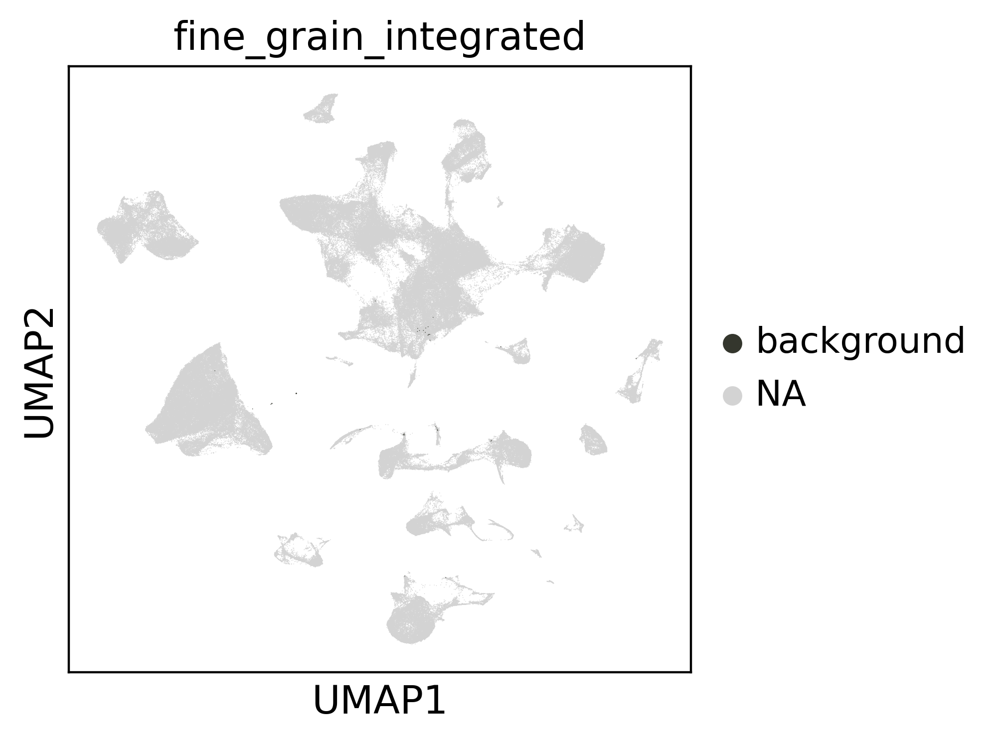

In [33]:
sc.pl.umap(adata, color=["mid_grain_integrated"],ncols=1, groups='background')
sc.pl.umap(adata, color=["fine_grain_integrated"],ncols=1, groups='background')

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


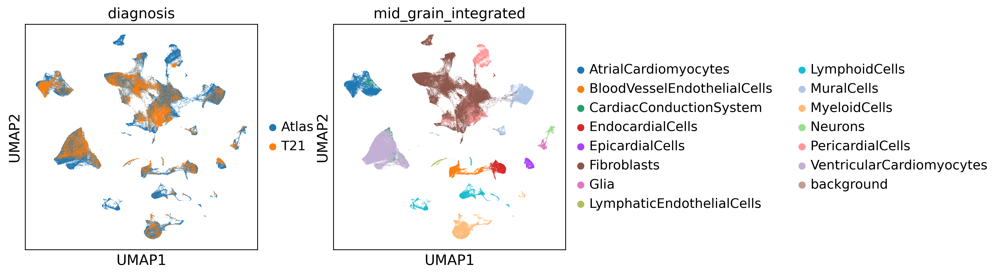

/lustre/scratch126/cellgen/team205/jc48/jupyter/scArches/fetal/3_AddLabelsToIntegratedObject/figures/umapAtlasT21Integrated.svg
Transferred:   	  873.019 KiB / 873.019 KiB, 100%, 0 B/s, ETA -
Transferred:            0 / 1, 0%
Elapsed time:         1.7s
Transferring:
 *                    umapAtlasT21Integrated.svg:100% /873.019Ki, 0/s, -Transferred:   	  873.019 KiB / 873.019 KiB, 100%, 0 B/s, ETA -
Transferred:            0 / 1, 0%
Elapsed time:         2.2s
Transferring:
 *                    umapAtlasT21Integrated.svg:100% /873.019Ki, 0/s, -Transferred:   	  873.019 KiB / 873.019 KiB, 100%, 872.947 KiB/s, ETA 0s
Transferred:            0 / 1, 0%
Elapsed time:         2.7s
Transferring:
 *                    umapAtlasT21Integrated.svg:100% /873.019Ki, 872.487Ki/s, 0Transferred:   	  873.019 KiB / 873.019 KiB, 100%, 872.947 KiB/s, ETA 0s
Transferred:            0 / 1, 0%
Elapsed time:         3.2s
Transferring:
 *                    umapAtlasT21Integrated.svg:100% /873.019Ki, 872.487K

In [16]:
# Save the UMAP plot
plot_name="AtlasT21Integrated.svg"
sc.pl.umap(adata, color=["diagnosis","mid_grain_integrated"], save=plot_name, ncols=2)
cwd=os.getcwd()
path=os.path.join(cwd,"figures","umap"+plot_name)
print(path)
! /software/rclone/rclone copy {path} gdrive:Sanger-CSCI_data_share/Manuscript/Figures/Figure6 --drive-shared-with-me --progress

# Save full object

In [35]:
adata

AnnData object with n_obs × n_vars = 373831 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'region', 'age', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', 'FACSgate', 'fine_grain', 'mid_grain', 'coarse_grain', 'sex', 'week', 'trimester', 'heart_or_greatvessels', 'cycling', 'S_score', 'G2M_score', 'phase', '_scvi_labels', 'stress_score', 'hb1_score', 'MidGrainModified', 'leiden', 'original_or_new', 'age_days', 'diagnosis', 'batch', 'cell_type', 'scANVI_predictions', 'coarse_pred

In [36]:
# convert adata.obsm keys to strings (were integers)
for key in adata.obsm.keys():
    if isinstance(adata.obsm[key], pd.DataFrame):
        adata.obsm[key].columns = adata.obsm[key].columns.astype(str)

### Save on NFS

In [37]:
file_path="/nfs/team205/heart/anndata_objects/Foetal/trisomy21/AtlasT21IntegratedRaw.h5ad"
adata.write(file_path)

### Save on gDrive

In [38]:
! /software/rclone/rclone lsd gdrive:Sanger-CSCI_data_share --drive-shared-with-me

          -1 2022-08-13 20:20:53        -1 13Aug
          -1 2022-07-22 22:49:24        -1 22Jul
          -1 2023-06-27 11:17:44        -1 27Jun23
          -1 2022-10-27 09:24:45        -1 27Oct
          -1 2022-09-27 13:51:41        -1 Analysis sections
          -1 2023-06-21 16:50:50        -1 CardioGRNs
          -1 2022-11-13 20:16:44        -1 Dewalla_hiPSC_SAN
          -1 2022-10-04 20:41:12        -1 Funakoshi_2021_iPSC_CM
          -1 2022-08-03 10:29:50        -1 Hill_2022_paediatric_CHD_data
          -1 2023-02-17 23:07:04        -1 JC_CMandNC_Feb23
          -1 2022-12-14 13:55:46        -1 JC_CMandNC_annotation_Dec22
          -1 2023-02-01 11:27:39        -1 Manuscript
          -1 2023-03-21 12:04:48        -1 Meeting
          -1 2023-01-10 16:53:16        -1 ReferencedHeartSections
          -1 2022-07-01 13:40:32        -1 Resources
          -1 2022-12-06 18:28:27        -1 Semih_Notebooks
          -1 2022-11-03 19:08:13        -1 ToJack
          -1 2023-01-3

In [39]:
! /software/rclone/rclone copy /nfs/team205/heart/anndata_objects/Foetal/trisomy21/AtlasT21IntegratedRaw.h5ad gdrive:Sanger-CSCI_data_share/27Jun23 --drive-shared-with-me --progress

Transferred:   	          0 B / 6.278 GiB, 0%, 0 B/s, ETA -
Transferred:            0 / 1, 0%
Elapsed time:         1.3s
Transferring:
 *                    AtlasT21IntegratedRaw.h5ad:  0% /6.278Gi, 0/s, -Transferred:   	       16 MiB / 6.278 GiB, 0%, 0 B/s, ETA -
Transferred:            0 / 1, 0%
Elapsed time:         1.8s
Transferring:
 *                    AtlasT21IntegratedRaw.h5ad:  0% /6.278Gi, 0/s, -Transferred:   	       32 MiB / 6.278 GiB, 0%, 23.978 MiB/s, ETA 4m26s
Transferred:            0 / 1, 0%
Elapsed time:         2.3s
Transferring:
 *                    AtlasT21IntegratedRaw.h5ad:  0% /6.278Gi, 23.976Mi/s, 4m26Transferred:   	       48 MiB / 6.278 GiB, 1%, 23.978 MiB/s, ETA 4m26s
Transferred:            0 / 1, 0%
Elapsed time:         2.8s
Transferring:
 *                    AtlasT21IntegratedRaw.h5ad:  0% /6.278Gi, 23.976Mi/s, 4m26Transferred:   	       64 MiB / 6.278 GiB, 1%, 27.996 MiB/s, ETA 3m47s
Transferred:            0 / 1, 0%
Elapsed time:         3.3s
Transf